In [1]:
import numpy as np                                                 # Implemennts milti-dimensional array and matrices
import pandas as pd                                                # For data manipulation and analysis
import pandas_profiling
import matplotlib.pyplot as plt                                    # Plotting library for Python programming language and it's numerical mathematics extension NumPy
import seaborn as sns                                              # Provides a high level interface for drawing attractive and informative statistical graphics
%matplotlib inline
sns.set()

from subprocess import check_output

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity= 'all'



Bad key "text.kerning_factor" on line 4 in
/opt/anaconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
events_data = pd.read_csv(r"/Users/kapil.gupta/Downloads/events_data.csv", dtype={'device_id':str})

In [3]:
events_data.isnull().sum()
events_data.shape


event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state        377
dtype: int64

(3252950, 7)

In [4]:

events_state_null = events_data[events_data['state'].isnull()]

In [5]:
events_state_null.info()
events_state_null.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 377 entries, 2931 to 3242228
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   event_id   377 non-null    int64  
 1   device_id  377 non-null    object 
 2   timestamp  377 non-null    object 
 3   longitude  377 non-null    float64
 4   latitude   377 non-null    float64
 5   city       377 non-null    object 
 6   state      0 non-null      object 
dtypes: float64(2), int64(1), object(4)
memory usage: 23.6+ KB


event_id       0
device_id      0
timestamp      0
longitude      0
latitude       0
city           0
state        377
dtype: int64

In [6]:
events_state_notnull = events_data[events_data['state'].notnull()]

In [7]:
citylist=list(events_state_notnull['city'])
statelist=list(events_state_notnull['state'])
city_state_dict={citylist[i]: statelist[i] for i in range(len(citylist))} 

In [8]:
import itertools
#for (a, b, c) in zip(num, color, value): 
for (i,j) in zip(events_state_null['city'], events_state_null['state']):
    for key, value in city_state_dict.items():
        if i==key:
            events_state_null['state']=value
                      

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [9]:
events_state_null.isnull().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

In [10]:
events_state_notnull.shape
events_state_null.shape

(3252573, 7)

(377, 7)

In [11]:
event_data=events_state_notnull.append(events_state_null)

In [12]:
event_data.isnull().sum()
event_data.shape

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state          0
dtype: int64

(3252950, 7)

In [13]:
event_data=event_data[event_data["state"].isin(["Gujarat","Karnataka","WestBengal","Bihar","Punjab", "Kerala"])]

In [14]:
null_data2 = event_data[event_data['longitude'].isnull()]
notnull_data2 = event_data[event_data['longitude'].notnull()]

null_data2.shape
notnull_data2.shape

(42, 7)

(422873, 7)

In [15]:
#To get the exect values of Latitude and logitude 
from geopy.geocoders import Nominatim
for location in null_data2['city']:
    #print(location)
    geolocator = Nominatim(user_agent=location)
    break
#geolocator = Nominatim(user_agent=location) 
locs = [ geolocator.geocode(addr) for addr in null_data2.city ]
geo_info = pd.DataFrame(
    [ (addr.address, addr.latitude, addr.longitude) for addr in locs ],
    columns=['city', 'latitude', 'longitude'])


In [16]:
geo_info["city"]= geo_info["city"].str.split(",", n = 1, expand = True) 
geo_info1=geo_info  
#reset index, this help copy data/assign data/column values from one dataframe to another data frame
geo_info1.index = null_data2.index
null_data2[['latitude','longitude']] = geo_info1[['latitude', 'longitude']]
eventdata3= notnull_data2.append(null_data2)
eventdata3.isnull().sum() #New event data

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


event_id      0
device_id    48
timestamp     0
longitude     0
latitude      0
city          0
state         0
dtype: int64

In [17]:
geo_info.shape
null_data2.shape
eventdata3.shape
eventdata3.isnull().sum()

(42, 3)

(42, 7)

(422915, 7)

event_id      0
device_id    48
timestamp     0
longitude     0
latitude      0
city          0
state         0
dtype: int64

In [18]:
device_null = eventdata3[eventdata3['device_id'].isnull()]
device_notnull=eventdata3[eventdata3['device_id'].notnull()]

device_null.head()
device_null.isnull().sum()
device_notnull.isnull().sum()

,event_id,device_id,timestamp,longitude,latitude,city,state
44823,3227383,NaN,2016-05-05 08:37:09,75.992551,31.561747,Hoshiarpur,Punjab
238324,1787536,NaN,2016-05-04 22:19:21,75.992551,31.561747,Hoshiarpur,Punjab
406144,118826,NaN,2016-05-06 22:05:48,73.169345,21.194283,Bardoli,Gujarat
452040,2676255,NaN,2016-05-02 20:37:30,70.686387,21.790693,Jetpur,Gujarat
463501,893484,NaN,2016-05-04 06:44:34,73.169345,21.194283,Bardoli,Gujarat


event_id      0
device_id    48
timestamp     0
longitude     0
latitude      0
city          0
state         0
dtype: int64

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

In [19]:
device_notnull.isnull().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

In [20]:
device_null[device_null['city']=='Hoshiarpur'].head()
device_null.shape
device_notnull[device_notnull['city']=='Hoshiarpur'].head()
device_notnull.shape

,event_id,device_id,timestamp,longitude,latitude,city,state
44823,3227383,NaN,2016-05-05 08:37:09,75.992551,31.561747,Hoshiarpur,Punjab
238324,1787536,NaN,2016-05-04 22:19:21,75.992551,31.561747,Hoshiarpur,Punjab
637962,2113651,NaN,2016-05-05 14:43:35,75.992551,31.561747,Hoshiarpur,Punjab
935429,1724313,NaN,2016-05-05 17:26:12,75.992551,31.561747,Hoshiarpur,Punjab
1320284,497214,NaN,2016-05-03 07:51:27,75.992551,31.561747,Hoshiarpur,Punjab


(48, 7)

,event_id,device_id,timestamp,longitude,latitude,city,state
3044,1759922,1750778632182066836,2016-05-01 23:20:24,75.992551,31.561747,Hoshiarpur,Punjab
7480,283872,-3923551471103946270,2016-05-02 16:57:48,75.963502,31.616521,Hoshiarpur,Punjab
9453,1322994,2062737921368467657,2016-05-03 22:30:20,75.961665,31.576109,Hoshiarpur,Punjab
12506,2015807,-4252602101177080386,2016-05-01 07:30:03,75.992041,31.623826,Hoshiarpur,Punjab
22036,61682,6808186066228960869,2016-05-06 22:31:14,75.975356,31.622665,Hoshiarpur,Punjab


(422867, 7)

In [21]:
device_null = device_null.reset_index(drop=True)
device_null.head()
device_notnull = device_notnull.reset_index(drop=True)
device_notnull.head(20)

,event_id,device_id,timestamp,longitude,latitude,city,state
0,3227383,NaN,2016-05-05 08:37:09,75.992551,31.561747,Hoshiarpur,Punjab
1,1787536,NaN,2016-05-04 22:19:21,75.992551,31.561747,Hoshiarpur,Punjab
2,118826,NaN,2016-05-06 22:05:48,73.169345,21.194283,Bardoli,Gujarat
3,2676255,NaN,2016-05-02 20:37:30,70.686387,21.790693,Jetpur,Gujarat
4,893484,NaN,2016-05-04 06:44:34,73.169345,21.194283,Bardoli,Gujarat


,event_id,device_id,timestamp,longitude,latitude,city,state
0,2955066,4734221357723754978,2016-05-01 20:44:16,88.388361,22.660325,Calcutta,WestBengal
1,769546,-1817502319478569661,2016-05-01 14:07:23,88.371813,22.662852,Calcutta,WestBengal
2,1750603,-5598137337131306950,2016-05-05 15:47:03,70.212684,23.118370,Gandhidham,Gujarat
3,3085968,-3808296883972395680,2016-05-07 01:25:47,75.513019,11.812367,Thalassery,Kerala
4,1407594,-2995507760806350372,2016-05-03 20:01:35,77.805194,13.533295,ChikBallapur,Karnataka
5,1447642,-8778262627556792908,2016-05-05 09:28:24,88.445866,22.610965,Calcutta,WestBengal
6,1913158,3633177046872420604,2016-05-02 20:10:01,74.096796,30.450612,Fazilka,Punjab
7,2563012,-637891494492896017,2016-05-05 19:29:39,88.452894,22.640237,Calcutta,WestBengal
8,2816916,-4556384955699299283,2016-05-02 23:25:30,75.251970,30.847549,Moga,Punjab
9,308714,-3541649923863661263,2016-05-01 14:35:55,77.616825,13.048771,Bangalore,Karnataka


In [22]:
#for i in range(len(device_null)):
#    if device_null['longitude'] == device_notnull['longitude']:
#        device_null['device_id'] = device_notnull['device_id']
        
device_null_log=list(device_null['longitude'])
device_notnull_log=list(device_notnull['longitude'])
device_notnull_device=list(device_notnull['device_id'])
device_notnull_dict={device_notnull_log[i]: device_notnull_device[i] for i in range(len(device_notnull_log))} 


#for (i,j) in zip(device_null['longitude'], device_notnull['longitude'] ):
#    if i==j:
#        device_null['device_id']=l
#    print (device_null['device_id'])
                      
        
    

In [23]:
device_notnull_dict

{88.388361: '4734221357723754978',
 88.371813: '-1817502319478569661',
 70.212684: '-5598137337131306950',
 75.513019: '-3808296883972395680',
 77.805194: '-2995507760806350372',
 88.44586600000002: '1948767057521470358',
 74.096796: '3633177046872420604',
 88.452894: '-637891494492896017',
 75.25197: '-4556384955699299283',
 77.616825: '-3541649923863661263',
 77.57423299999998: '4614501649961248589',
 88.240061: '-5195659847995299475',
 88.425271: '-4832071499847333987',
 88.370968: '8383544711124042789',
 88.447362: '187204588687540990',
 88.41205599999998: '7773538137645643436',
 88.48839100000002: '3965171757752128530',
 88.112248: '9106560440142312420',
 88.43459200000002: '-3700927877237364808',
 88.379129: '-282716438821973107',
 75.86157299999998: '961488877246982835',
 88.421346: '1668299127505997117',
 77.575243: '6738525671100046982',
 88.175577: '3084418677851400207',
 71.807354: '722189375076479588',
 76.961038: '-527226872823879871',
 74.267689: '-8284788964525239011',
 

In [24]:
nulldevicelist=[]
import itertools
#for (a, b, c) in zip(num, color, value): 
for i in device_null_log:
    for key, value in device_notnull_dict.items():
        if i==key:
            nulldevicelist.append(value)
            #device_null['device_id']=value

In [25]:
len(nulldevicelist)
nulldevicelist

48

['1750778632182066836',
 '1750778632182066836',
 '-8215770519233685145',
 '-1688015122502424125',
 '-8215770519233685145',
 '-1688015122502424125',
 '-8215770519233685145',
 '-1688015122502424125',
 '-8215770519233685145',
 '1750778632182066836',
 '-8215770519233685145',
 '-1688015122502424125',
 '1750778632182066836',
 '-8215770519233685145',
 '-1688015122502424125',
 '1750778632182066836',
 '-8215770519233685145',
 '1750778632182066836',
 '-8215770519233685145',
 '1750778632182066836',
 '-8215770519233685145',
 '-8215770519233685145',
 '-1688015122502424125',
 '-8215770519233685145',
 '-1688015122502424125',
 '-8215770519233685145',
 '-1688015122502424125',
 '-1688015122502424125',
 '1750778632182066836',
 '-8215770519233685145',
 '1750778632182066836',
 '1750778632182066836',
 '-1688015122502424125',
 '1750778632182066836',
 '-8215770519233685145',
 '-1688015122502424125',
 '1750778632182066836',
 '-8215770519233685145',
 '1750778632182066836',
 '-1688015122502424125',
 '-1688015122

In [26]:
#df = DataFrame (your_list,columns=['Column_Name'])
device_null['device_id'] = pd.DataFrame(nulldevicelist)

In [27]:
device_null.isnull().sum()
device_null.head()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

,event_id,device_id,timestamp,longitude,latitude,city,state
0,3227383,1750778632182066836,2016-05-05 08:37:09,75.992551,31.561747,Hoshiarpur,Punjab
1,1787536,1750778632182066836,2016-05-04 22:19:21,75.992551,31.561747,Hoshiarpur,Punjab
2,118826,-8215770519233685145,2016-05-06 22:05:48,73.169345,21.194283,Bardoli,Gujarat
3,2676255,-1688015122502424125,2016-05-02 20:37:30,70.686387,21.790693,Jetpur,Gujarat
4,893484,-8215770519233685145,2016-05-04 06:44:34,73.169345,21.194283,Bardoli,Gujarat


In [28]:
#event_data=events_state_notnull.append(events_state_null)
eventdata4= pd.concat([device_notnull,device_null])
    

In [29]:
eventdata4['timestamp'] = pd.to_datetime(eventdata4['timestamp']) #convert the timestamp in datetime64 format

In [30]:
eventdata4.isnull().sum()
eventdata4.shape
eventdata4.device_id = eventdata4.device_id.astype(np.float64)
eventdata4.info()


event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

(422915, 7)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422915 entries, 0 to 47
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   event_id   422915 non-null  int64         
 1   device_id  422915 non-null  float64       
 2   timestamp  422915 non-null  datetime64[ns]
 3   longitude  422915 non-null  float64       
 4   latitude   422915 non-null  float64       
 5   city       422915 non-null  object        
 6   state      422915 non-null  object        
dtypes: datetime64[ns](1), float64(3), int64(1), object(2)
memory usage: 25.8+ MB


In [31]:
eventdata_final= eventdata4.copy(deep='True')

In [32]:
import mysql.connector
import mysql.connector as sql
import pandas as pd
db_connection = sql.connect(host='cpanel.insaid.co', database='Capstone1', user='student', password='student')

db_cursor = db_connection.cursor()
db_cursor.execute("SHOW TABLES")
databases = db_cursor.fetchall()
print(databases)
for database in databases:
    print(database)
db_cursor.execute('SELECT * FROM gender_age_train' )

table_rows = db_cursor.fetchall()
db_cursor.close()
db_connection.close()
df_gender_age = pd.DataFrame(table_rows)
df_gender_age.to_csv("gender_age_train.csv", index=False)
df_gender_age.head()

[('events_data',), ('gender_age_train',), ('phone_brand_device_model',)]
('events_data',)
('gender_age_train',)
('phone_brand_device_model',)


True

,0,1,2,3
0,-8076087639492063270,M,35,M32-38
1,-2897161552818060146,M,35,M32-38
2,-8260683887967679142,M,35,M32-38
3,-4938849341048082022,M,30,M29-31
4,245133531816851882,M,30,M29-31


In [33]:
df_gender_age.rename(columns={0:'device_id',1:'gender', 2:'age', 3:'Gen_age_range'}, inplace=True)


In [34]:
df_gender_age.info()
#df_gender_age.device_id = df_gender_age.device_id.astype(str)
df_gender_age.device_id = df_gender_age.device_id.astype(np.float64)
df_gender_age.info()
df_gender_age.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   device_id      74645 non-null  int64 
 1   gender         74645 non-null  object
 2   age            74645 non-null  int64 
 3   Gen_age_range  74645 non-null  object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   device_id      74645 non-null  float64
 1   gender         74645 non-null  object 
 2   age            74645 non-null  int64  
 3   Gen_age_range  74645 non-null  object 
dtypes: float64(1), int64(1), object(2)
memory usage: 2.3+ MB


,device_id,gender,age,Gen_age_range
0,-8.076088e+18,M,35,M32-38
1,-2.897162e+18,M,35,M32-38
2,-8.260684e+18,M,35,M32-38
3,-4.938849e+18,M,30,M29-31
4,2.451335e+17,M,30,M29-31


In [35]:
df_gender_age.isnull().sum()

device_id        0
gender           0
age              0
Gen_age_range    0
dtype: int64

#connect with sql database of phone_brand_device_model

In [62]:
db_connection = sql.connect(host='cpanel.insaid.co', database='Capstone1', user='student', password='student')

db_cursor = db_connection.cursor()
db_cursor.execute('SELECT * FROM phone_brand_device_model' )

table_rows = db_cursor.fetchall()
db_cursor.close()
db_connection.close()
df_phone_brand_device_model = pd.DataFrame(table_rows)
df_phone_brand_device_model.to_csv("phone_brand_device_model.csv", index=False)
df_phone_brand_device_model.head()

True

,0,1,2
0,1877775838486905855,vivo,Y13
1,-3766087376657242966,小米,V183
2,-6238937574958215831,OPPO,R7s
3,8973197758510677470,三星,A368t
4,-2015528097870762664,小米,红米Note2


In [63]:
df_phone_brand_device_model.rename(columns={0:'device_id',1:'brand', 2:'model'}, inplace=True)

In [64]:
df_phone_brand_device_model.device_id = df_phone_brand_device_model.device_id.astype(np.float64)
df_phone_brand_device_model.head()

,device_id,brand,model
0,1.877776e+18,vivo,Y13
1,-3.766087e+18,小米,V183
2,-6.238938e+18,OPPO,R7s
3,8.973198e+18,三星,A368t
4,-2.015528e+18,小米,红米Note2


In [65]:
df_phone_brand_device_model.isnull().sum()
df_phone_brand_device_model.info()

device_id    0
brand        0
model        0
dtype: int64

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   device_id  87726 non-null  float64
 1   brand      87726 non-null  object 
 2   model      87726 non-null  object 
dtypes: float64(1), object(2)
memory usage: 2.0+ MB


In [66]:
df_left1 = pd.merge(eventdata_final, df_gender_age, on='device_id', how='left')

In [67]:
df_new= pd.merge(df_left1, df_phone_brand_device_model, on='device_id', how='left'  )

In [68]:
df_new.head()
df_new.shape
df_new.isnull().sum()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,Gen_age_range,brand,model
0,2955066,4.734221e+18,2016-05-01 20:44:16,88.388361,22.660325,Calcutta,WestBengal,M,30,M29-31,vivo,X5M
1,769546,-1.817502e+18,2016-05-01 14:07:23,88.371813,22.662852,Calcutta,WestBengal,F,43,F43+,OPPO,R819T
2,1750603,-5.598137e+18,2016-05-05 15:47:03,70.212684,23.118370,Gandhidham,Gujarat,M,23,M23-26,魅族,MX3
3,3085968,-3.808297e+18,2016-05-07 01:25:47,75.513019,11.812367,Thalassery,Kerala,M,24,M23-26,vivo,X5L
4,1407594,-2.995508e+18,2016-05-03 20:01:35,77.805194,13.533295,ChikBallapur,Karnataka,M,29,M29-31,OPPO,R7 Plus


(422915, 12)

event_id         0
device_id        0
timestamp        0
longitude        0
latitude         0
city             0
state            0
gender           0
age              0
Gen_age_range    0
brand            0
model            0
dtype: int64

In [69]:
df_new.device_id.nunique()

19032

In [70]:
brandlist_mixlan=list(df_new.brand.unique())

In [71]:
print(brandlist_mixlan)

['vivo', 'OPPO', '魅族', '三星', '努比亚', '小米', '华为', '酷派', '华硕', '锤子', '乐视', 'HTC', '海信', 'TCL', '天语', '中国移动', 'ZUK', 'LG', '联想 ', '优米', '一加', '语信', '美图', '朵唯', '斐讯', '奇酷', '唯米', '酷比魔方', '富可视', '摩托罗拉', '神舟', '昂达', '青橙', '凯利通', '乡米', 'LOGO', '梦米', '青葱', '聆韵', '维图', '亿通', '波导', '海尔', '至尊宝', '优购', '艾优尼', '康佳', 'Lovme', '易派', '百立丰', '诺基亚', '欧博信', '纽曼', '酷珀', '先锋', '邦华', '宝捷讯', '酷比', '小杨树', '糯米', '鲜米', '沃普丰', '台电', '黑米', '优语', '米歌', '夏新', '广信', '欧新', '惠普', '虾米', '贝尔丰', '谷歌', '白米', '大可乐', '爱派尔', '蓝魔', '果米', '大Q', '长虹', '欧奇', '西米', '尼比鲁', '糖葫芦', 'E派', '飞利浦', '诺亚信', 'PPTV', '德赛', '普耐尔', '欧比']


In [72]:
#using google translator to translate the mix languages to english

In [73]:
from googletrans import Translator
brnadtransout={}
translator = Translator()
result = translator.translate(brandlist_mixlan, dest='en')
for trans in result:
    brnadtransout[trans.origin] = trans.text
brnadtransout

{'vivo': 'vivo',
 'OPPO': 'OPPO',
 '魅族': 'Meizu',
 '三星': 'Samsung',
 '努比亚': 'Nubian',
 '小米': 'Xiaomi',
 '华为': 'Huawei',
 '酷派': 'Coolpad',
 '华硕': 'Asus',
 '锤子': 'hammer',
 '乐视': 'Letv',
 'HTC': 'HTC',
 '海信': 'Hisense',
 'TCL': 'TCL',
 '天语': 'Amagatarai',
 '中国移动': 'China Mobile',
 'ZUK': 'YOU',
 'LG': 'LG',
 '联想 ': 'Lenovo',
 '优米': 'Quality rice',
 '一加': 'OnePlus',
 '语信': 'Language letter',
 '美图': 'Mito',
 '朵唯': 'Dove',
 '斐讯': 'Phicomm',
 '奇酷': 'Qiku',
 '唯米': 'Wei Mi',
 '酷比魔方': 'Cube',
 '富可视': 'InFocus',
 '摩托罗拉': 'Motorola',
 '神舟': 'Shenzhou',
 '昂达': 'Onda',
 '青橙': 'Green orange',
 '凯利通': 'Kellyton',
 '乡米': 'Xiangmi',
 'LOGO': 'LOGO',
 '梦米': 'Dream rice',
 '青葱': 'Shallots',
 '聆韵': 'Listen to rhyme',
 '维图': 'Vitu',
 '亿通': 'Toru',
 '波导': 'waveguide',
 '海尔': 'Haier',
 '至尊宝': 'Extreme treasure',
 '优购': 'Yougo',
 '艾优尼': 'Ayuni',
 '康佳': 'Konka',
 'Lovme': 'Lovme',
 '易派': 'Yipai',
 '百立丰': 'Bilifeng',
 '诺基亚': 'Nokia',
 '欧博信': 'Obersin',
 '纽曼': 'Newman',
 '酷珀': 'Amber',
 '先锋': 'pioneer',
 '邦华': '

In [74]:
item=[]
for i in df_new['brand']:
    for key, value in brnadtransout.items():
        if i in key: 
           # print("i",i)
           # print("key",key)
           # print("value",value)
            item.append({value})
            break
print(item)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [75]:
df_new['new_brand'] = pd.DataFrame(item) 

In [76]:
df_new.head()
df_new.shape
df_new.isnull().sum()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,Gen_age_range,brand,model,new_brand
0,2955066,4.734221e+18,2016-05-01 20:44:16,88.388361,22.660325,Calcutta,WestBengal,M,30,M29-31,vivo,X5M,vivo
1,769546,-1.817502e+18,2016-05-01 14:07:23,88.371813,22.662852,Calcutta,WestBengal,F,43,F43+,OPPO,R819T,OPPO
2,1750603,-5.598137e+18,2016-05-05 15:47:03,70.212684,23.118370,Gandhidham,Gujarat,M,23,M23-26,魅族,MX3,Meizu
3,3085968,-3.808297e+18,2016-05-07 01:25:47,75.513019,11.812367,Thalassery,Kerala,M,24,M23-26,vivo,X5L,vivo
4,1407594,-2.995508e+18,2016-05-03 20:01:35,77.805194,13.533295,ChikBallapur,Karnataka,M,29,M29-31,OPPO,R7 Plus,OPPO


(422915, 13)

event_id         0
device_id        0
timestamp        0
longitude        0
latitude         0
city             0
state            0
gender           0
age              0
Gen_age_range    0
brand            0
model            0
new_brand        0
dtype: int64

In [77]:
df_new['age_group'] = pd.cut(x = df_new['age'], bins = [1,9,19,29,39,49,59,69,79], labels = ['<10','10-19','20-29','30-39','40-49','50-59','60-69','70-99'])



In [78]:
df_new.drop('Gen_age_range', axis=1, inplace=True)
df_new.head()
df_new.info()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,brand,model,new_brand,age_group
0,2955066,4.734221e+18,2016-05-01 20:44:16,88.388361,22.660325,Calcutta,WestBengal,M,30,vivo,X5M,vivo,30-39
1,769546,-1.817502e+18,2016-05-01 14:07:23,88.371813,22.662852,Calcutta,WestBengal,F,43,OPPO,R819T,OPPO,40-49
2,1750603,-5.598137e+18,2016-05-05 15:47:03,70.212684,23.118370,Gandhidham,Gujarat,M,23,魅族,MX3,Meizu,20-29
3,3085968,-3.808297e+18,2016-05-07 01:25:47,75.513019,11.812367,Thalassery,Kerala,M,24,vivo,X5L,vivo,20-29
4,1407594,-2.995508e+18,2016-05-03 20:01:35,77.805194,13.533295,ChikBallapur,Karnataka,M,29,OPPO,R7 Plus,OPPO,20-29


<class 'pandas.core.frame.DataFrame'>
Int64Index: 422915 entries, 0 to 422914
Data columns (total 13 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   event_id   422915 non-null  int64         
 1   device_id  422915 non-null  float64       
 2   timestamp  422915 non-null  datetime64[ns]
 3   longitude  422915 non-null  float64       
 4   latitude   422915 non-null  float64       
 5   city       422915 non-null  object        
 6   state      422915 non-null  object        
 7   gender     422915 non-null  object        
 8   age        422915 non-null  int64         
 9   brand      422915 non-null  object        
 10  model      422915 non-null  object        
 11  new_brand  422915 non-null  object        
 12  age_group  422445 non-null  category      
dtypes: category(1), datetime64[ns](1), float64(3), int64(2), object(6)
memory usage: 42.3+ MB


In [79]:
df_user.state.unique()

array(['WestBengal', 'Gujarat', 'Kerala', 'Karnataka', 'Punjab', 'Bihar'],
      dtype=object)

In [80]:
1. Distribution of Users(device_id) across States.

SyntaxError: invalid syntax (<ipython-input-80-72486ccf8b89>, line 1)

In [81]:
df_new.head()
#selected_columns = ['device_id', 'longitude', 'latitude','state', 'new_brand', 'model']
df_user =df_new[['device_id','city','state','latitude','longitude','new_brand', 'model', 'gender', 'age', 'city','age_group'] ]
df_user.head()
df_user.shape
df_new.shape
#eventdata=eventdata[eventdata["state"].isin(["Gujarat","Karnataka","WestBengal","Bihar","Punjab", "Kerala"])]


,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,brand,model,new_brand,age_group
0,2955066,4.734221e+18,2016-05-01 20:44:16,88.388361,22.660325,Calcutta,WestBengal,M,30,vivo,X5M,vivo,30-39
1,769546,-1.817502e+18,2016-05-01 14:07:23,88.371813,22.662852,Calcutta,WestBengal,F,43,OPPO,R819T,OPPO,40-49
2,1750603,-5.598137e+18,2016-05-05 15:47:03,70.212684,23.118370,Gandhidham,Gujarat,M,23,魅族,MX3,Meizu,20-29
3,3085968,-3.808297e+18,2016-05-07 01:25:47,75.513019,11.812367,Thalassery,Kerala,M,24,vivo,X5L,vivo,20-29
4,1407594,-2.995508e+18,2016-05-03 20:01:35,77.805194,13.533295,ChikBallapur,Karnataka,M,29,OPPO,R7 Plus,OPPO,20-29


,device_id,city,state,latitude,longitude,new_brand,model,gender,age,city,age_group
0,4.734221e+18,Calcutta,WestBengal,22.660325,88.388361,vivo,X5M,M,30,Calcutta,30-39
1,-1.817502e+18,Calcutta,WestBengal,22.662852,88.371813,OPPO,R819T,F,43,Calcutta,40-49
2,-5.598137e+18,Gandhidham,Gujarat,23.118370,70.212684,Meizu,MX3,M,23,Gandhidham,20-29
3,-3.808297e+18,Thalassery,Kerala,11.812367,75.513019,vivo,X5L,M,24,Thalassery,20-29
4,-2.995508e+18,ChikBallapur,Karnataka,13.533295,77.805194,OPPO,R7 Plus,M,29,ChikBallapur,20-29


(422915, 11)

(422915, 13)

In [82]:
df_user.shape
#df_user.device_id.nunique()
df_user['device_id'].nunique()

(422915, 11)

19032

In [83]:
df_user.nunique()

device_id    19032
city           311
state            6
latitude     18801
longitude    18732
new_brand       90
model         1092
gender           2
age             76
city           311
age_group        7
dtype: int64

In [84]:
df_test = df_user.copy(deep='True')

In [85]:
#as one user is duplicated many times to create eventsm hence we are removing the duplicates
df_user.drop_duplicates(subset ="device_id", inplace = True)

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [86]:
df_user.shape
df_user.head()

(19032, 11)

,device_id,city,state,latitude,longitude,new_brand,model,gender,age,city,age_group
0,4.734221e+18,Calcutta,WestBengal,22.660325,88.388361,vivo,X5M,M,30,Calcutta,30-39
1,-1.817502e+18,Calcutta,WestBengal,22.662852,88.371813,OPPO,R819T,F,43,Calcutta,40-49
2,-5.598137e+18,Gandhidham,Gujarat,23.118370,70.212684,Meizu,MX3,M,23,Gandhidham,20-29
3,-3.808297e+18,Thalassery,Kerala,11.812367,75.513019,vivo,X5L,M,24,Thalassery,20-29
4,-2.995508e+18,ChikBallapur,Karnataka,13.533295,77.805194,OPPO,R7 Plus,M,29,ChikBallapur,20-29


In [111]:
df_user.to_csv(r' df_user.csv')

In [87]:
df_user.state.unique()

array(['WestBengal', 'Gujarat', 'Kerala', 'Karnataka', 'Punjab', 'Bihar'],
      dtype=object)

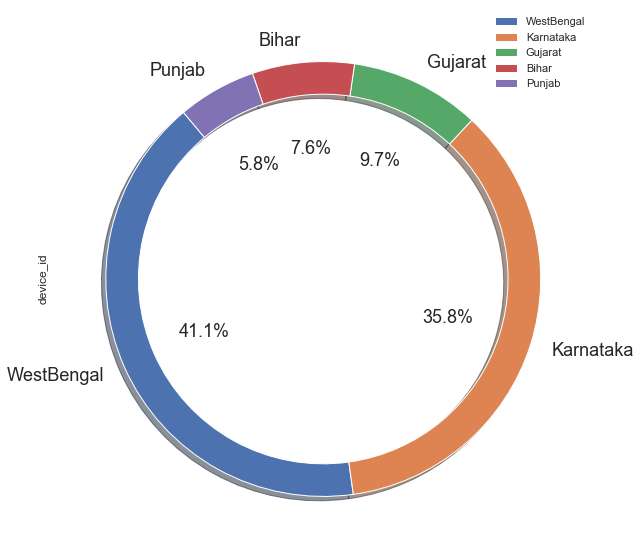

In [88]:
df_user.groupby(['state'])['device_id'].count().sort_values(ascending = False)[0:5].plot(kind='pie', fontsize=18, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(10,10), legend=True)
    


plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("state"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['new_brand'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=22, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(50,50), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
plt.tight_layout()


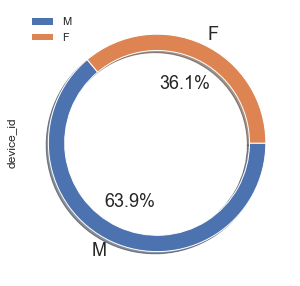

In [90]:
df_user.groupby(['gender'])['device_id'].count().sort_values(ascending = False)[0:5].plot(kind='pie', fontsize=18, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(5,5), legend=True)


3.2.per state wise gender distribuation 

<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, 'Bihar')

Text(0.5, 1.0, 'Gujarat')

Text(0.5, 1.0, 'Karnataka')

Text(0.5, 1.0, 'Kerala')

Text(0.5, 1.0, 'Punjab')

Text(0.5, 1.0, 'WestBengal')

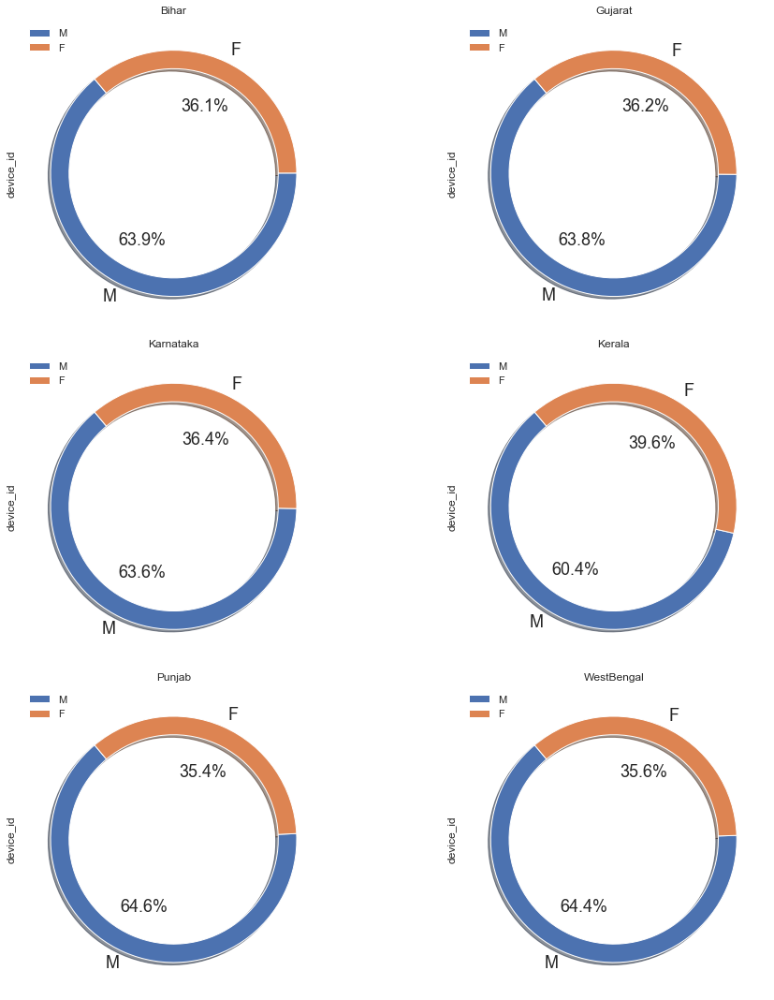

In [91]:
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("state"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['gender'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=18, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(15,15), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
plt.tight_layout()


,device_id,city,state,latitude,longitude,new_brand,model,gender,age,city,age_group
0,4.734221e+18,Calcutta,WestBengal,22.660325,88.388361,vivo,X5M,M,30,Calcutta,30-39
1,-1.817502e+18,Calcutta,WestBengal,22.662852,88.371813,OPPO,R819T,F,43,Calcutta,40-49
2,-5.598137e+18,Gandhidham,Gujarat,23.118370,70.212684,Meizu,MX3,M,23,Gandhidham,20-29
3,-3.808297e+18,Thalassery,Kerala,11.812367,75.513019,vivo,X5L,M,24,Thalassery,20-29
4,-2.995508e+18,ChikBallapur,Karnataka,13.533295,77.805194,OPPO,R7 Plus,M,29,ChikBallapur,20-29


(19032, 11)

Text(0, 0.5, 'Count')

Text(0.5, 1.0, 'user distribuation in differnet age group')

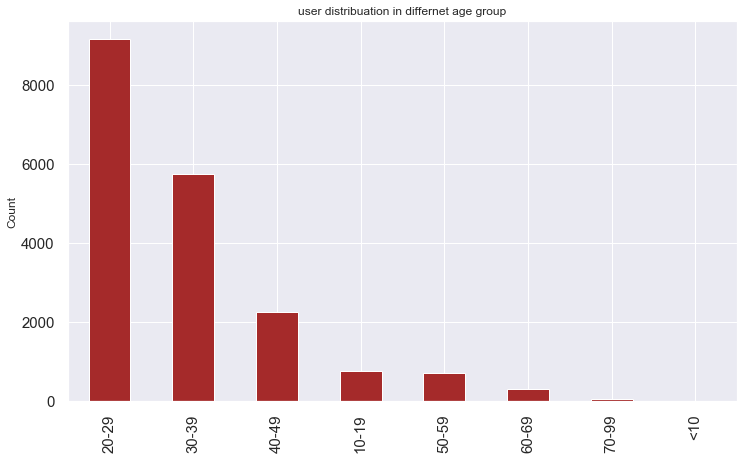

In [92]:
df_user.head()
df_user.shape

use_dist=df_user['age_group'].value_counts().plot(kind='bar', figsize=(12,7), fontsize=15, color='brown')
plt.ylabel('Count')
plt.title('user distribuation in differnet age group')


In [93]:
5. Distribution of Phone Brands(Consider only 10 Most used Phone Brands) for each Age Segment, State, Gender.


SyntaxError: invalid syntax (<ipython-input-93-0b965663dea6>, line 1)

In [ ]:
Top_phone_brand=df_user['state'].value_counts()[0:5].plot(kind='bar', figsize=(12,7), fontsize=15, color='brown')
plt.ylabel('Count')
plt.title('top 5 state in Mobile uses')

<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, 'Bihar')

Text(0.5, 1.0, 'Gujarat')

Text(0.5, 1.0, 'Karnataka')

Text(0.5, 1.0, 'Kerala')

Text(0.5, 1.0, 'Punjab')

Text(0.5, 1.0, 'WestBengal')

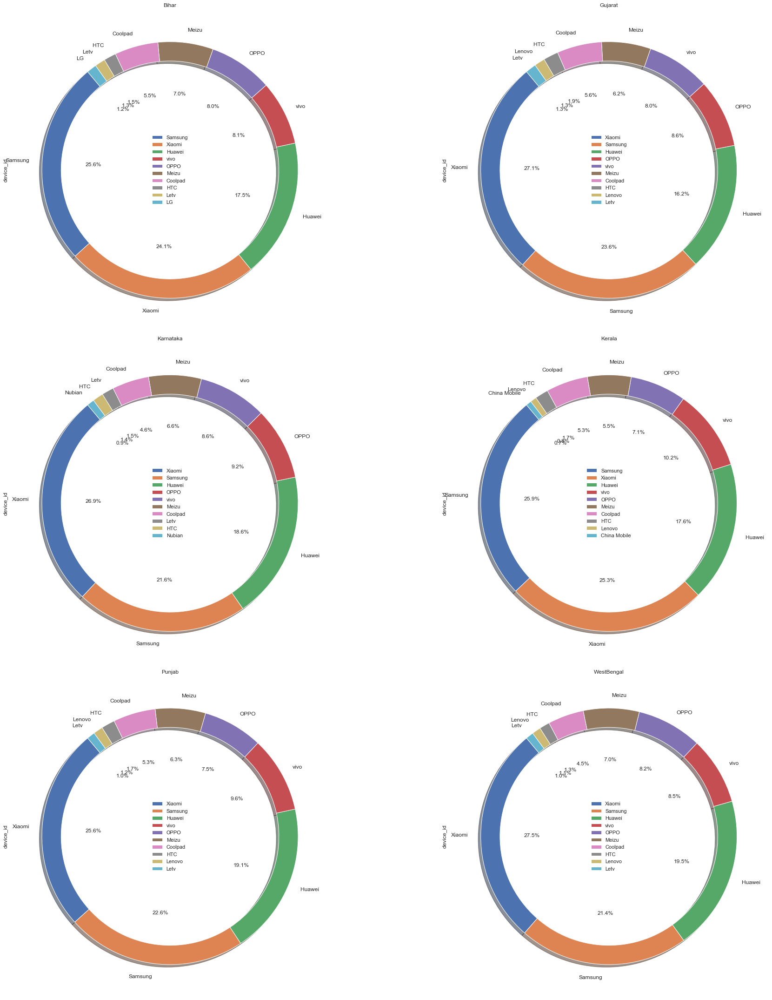

In [94]:
#top 10 Mobile brands in states in uses
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("state"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['new_brand'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=12, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
plt.tight_layout()


<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, '<10')

Text(0.5, 1.0, '10-19')

Text(0.5, 1.0, '20-29')

Text(0.5, 1.0, '30-39')

Text(0.5, 1.0, '40-49')

Text(0.5, 1.0, '50-59')

Text(0.5, 1.0, '60-69')

Text(0.5, 1.0, '70-99')

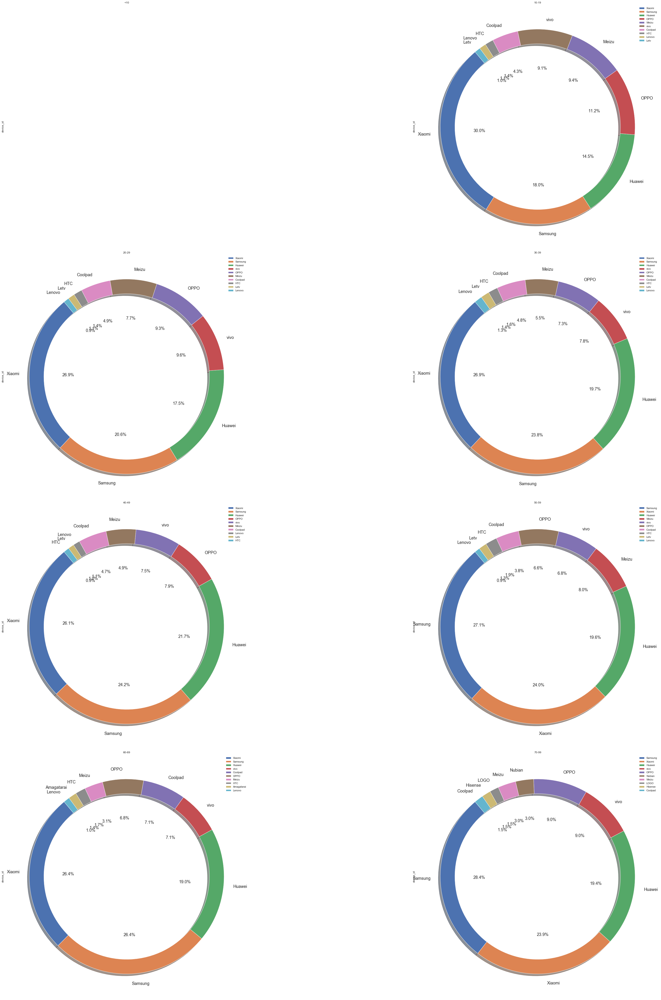

In [95]:
#top 10 Mobile brands in age_group in uses
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("age_group"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(4, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['new_brand'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=18, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(60,60), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
plt.tight_layout()


<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, 'F')

Text(0.5, 1.0, 'M')

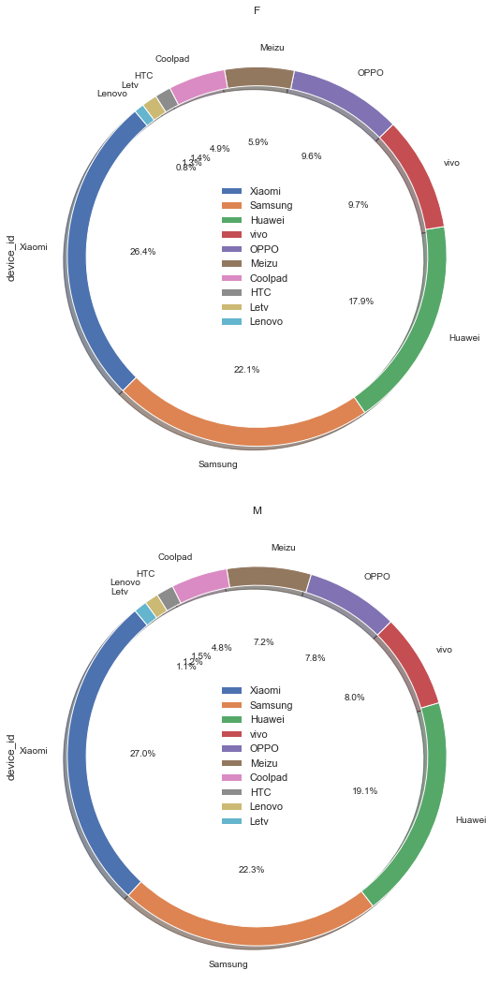

In [96]:
#top 10 Mobile brands in genders 
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("gender"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(2, 1, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['new_brand'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=10, autopct='%3.1f%%', wedgeprops=dict(width=0.10), shadow=True, startangle=130, figsize=(15,15), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()


<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, 'Bihar')

Text(0.5, 1.0, 'Gujarat')

Text(0.5, 1.0, 'Karnataka')

Text(0.5, 1.0, 'Kerala')

Text(0.5, 1.0, 'Punjab')

Text(0.5, 1.0, 'WestBengal')

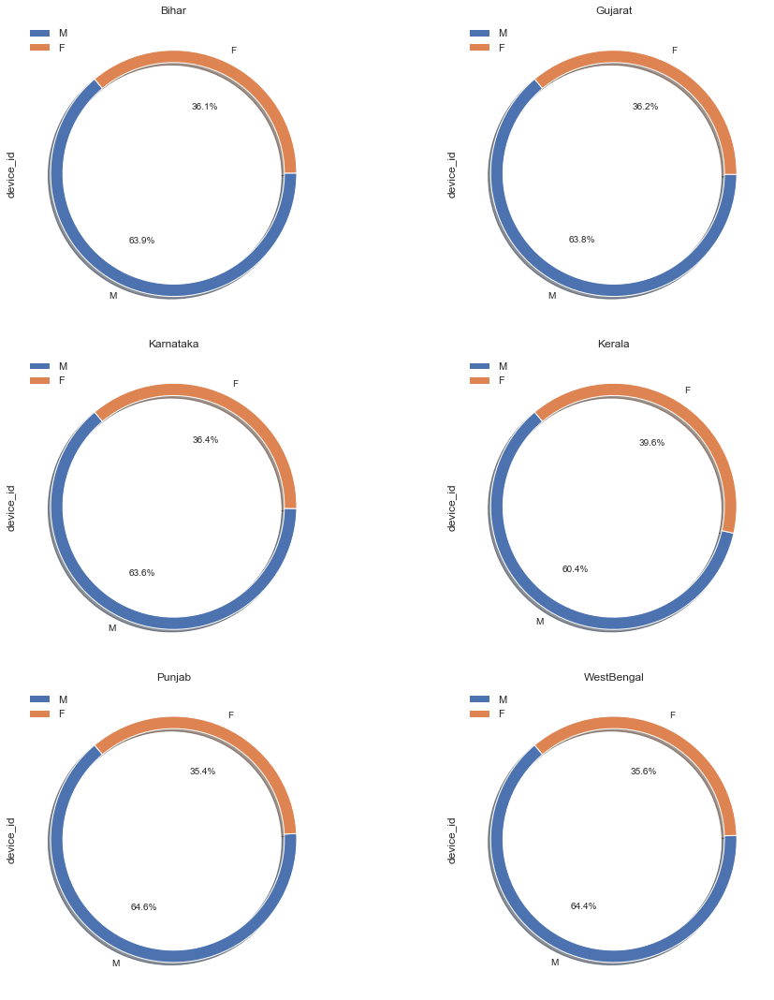

In [97]:
#distribuation of genders in states 
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("state"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['gender'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=10, autopct='%3.1f%%', wedgeprops=dict(width=0.10), shadow=True, startangle=130, figsize=(15,15), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()

<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, '<10')

Text(0.5, 1.0, '10-19')

Text(0.5, 1.0, '20-29')

Text(0.5, 1.0, '30-39')

Text(0.5, 1.0, '40-49')

Text(0.5, 1.0, '50-59')

Text(0.5, 1.0, '60-69')

Text(0.5, 1.0, '70-99')

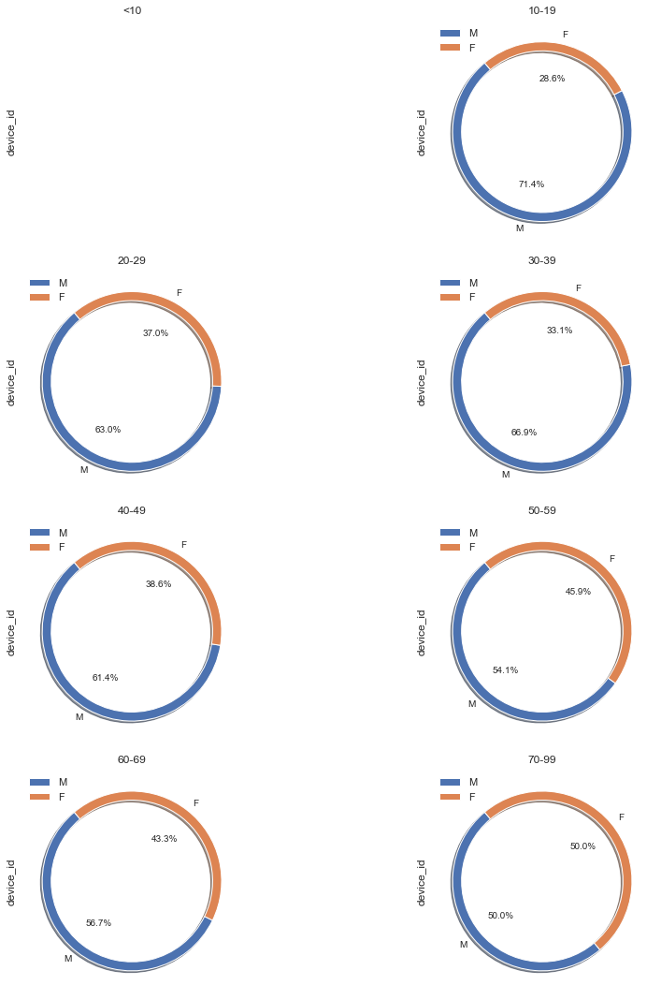

In [98]:
#distribuation of genders in age segmengts 
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("age_group"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(4, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['gender'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=10, autopct='%3.1f%%', wedgeprops=dict(width=0.10), shadow=True, startangle=130, figsize=(15,15), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()

In [99]:
Topbrands=df_user['new_brand'].value_counts()[:10]

In [100]:
Topbrand = list(Topbrands.index)
Topbrand
df_user.head()

['Xiaomi',
 'Samsung',
 'Huawei',
 'vivo',
 'OPPO',
 'Meizu',
 'Coolpad',
 'HTC',
 'Letv',
 'Lenovo']

,device_id,city,state,latitude,longitude,new_brand,model,gender,age,city,age_group
0,4.734221e+18,Calcutta,WestBengal,22.660325,88.388361,vivo,X5M,M,30,Calcutta,30-39
1,-1.817502e+18,Calcutta,WestBengal,22.662852,88.371813,OPPO,R819T,F,43,Calcutta,40-49
2,-5.598137e+18,Gandhidham,Gujarat,23.118370,70.212684,Meizu,MX3,M,23,Gandhidham,20-29
3,-3.808297e+18,Thalassery,Kerala,11.812367,75.513019,vivo,X5L,M,24,Thalassery,20-29
4,-2.995508e+18,ChikBallapur,Karnataka,13.533295,77.805194,OPPO,R7 Plus,M,29,ChikBallapur,20-29


In [101]:
#dfnew=df_left2.query('state == ["Gujarat","Karnataka","WestBengal","Bihar","Punjab", "Kerala"]')
#dfnew=df_left2.query('state == ["Gujarat","Karnataka","WestBengal","Bihar","Punjab", "Kerala"]')
dfTopbrands = df_user.query("new_brand == ['Xiaomi', 'Samsung', 'Huawei', 'OPPO', 'vivo', 'Meizu', 'Coolpad', 'HTC', 'Letv', 'Lenovo']")


<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, 'Coolpad')

Text(0.5, 1.0, 'HTC')

Text(0.5, 1.0, 'Huawei')

Text(0.5, 1.0, 'Lenovo')

Text(0.5, 1.0, 'Letv')

Text(0.5, 1.0, 'Meizu')

Text(0.5, 1.0, 'OPPO')

Text(0.5, 1.0, 'Samsung')

Text(0.5, 1.0, 'Xiaomi')

Text(0.5, 1.0, 'vivo')

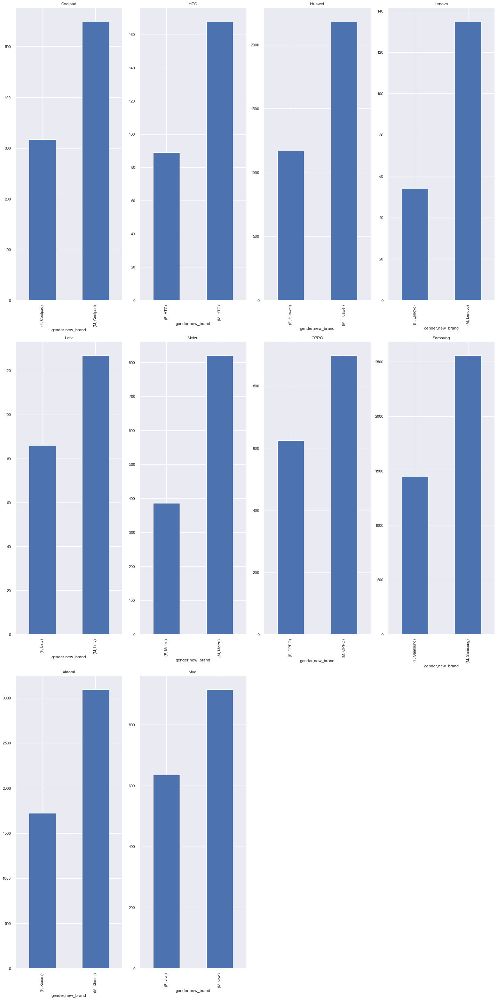

In [102]:
#distribuation of genders in brand segmengts 

plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in dfTopbrands.groupby("new_brand"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 4, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['gender'])['new_brand'].value_counts()[:10].sort_values(ascending = True).plot(kind='bar',)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()

In [103]:
7. Distribution of Age Segments for each State, Gender and Phone Brand(Consider only 10 Most used Phone Brands).

SyntaxError: invalid syntax (<ipython-input-103-39b66954fb97>, line 1)

In [ ]:
#distribuation of age_group in states 
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("state"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['age_group'])['device_id'].count().sort_values(ascending = False)[0:10].plot(kind='pie', fontsize=10, autopct='%3.1f%%', wedgeprops=dict(width=0.10), shadow=True, startangle=130, figsize=(30,30), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()

In [ ]:
#distribuation of age_group in Gender 
plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in df_user.groupby("gender"):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(3, 2, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection.groupby(['age_group'])['device_id'].count().sort_values(ascending = False).plot(kind='pie', fontsize=15, autopct='%3.1f%%', wedgeprops=dict(width=0.10), shadow=True, startangle=130, figsize=(40,40), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()

<Figure size 1440x2880 with 0 Axes>

Text(0.5, 1.0, 'Coolpad')

Text(0.5, 1.0, 'HTC')

Text(0.5, 1.0, 'Huawei')

Text(0.5, 1.0, 'Lenovo')

Text(0.5, 1.0, 'Letv')

Text(0.5, 1.0, 'Meizu')

Text(0.5, 1.0, 'OPPO')

Text(0.5, 1.0, 'Samsung')

Text(0.5, 1.0, 'Xiaomi')

Text(0.5, 1.0, 'vivo')

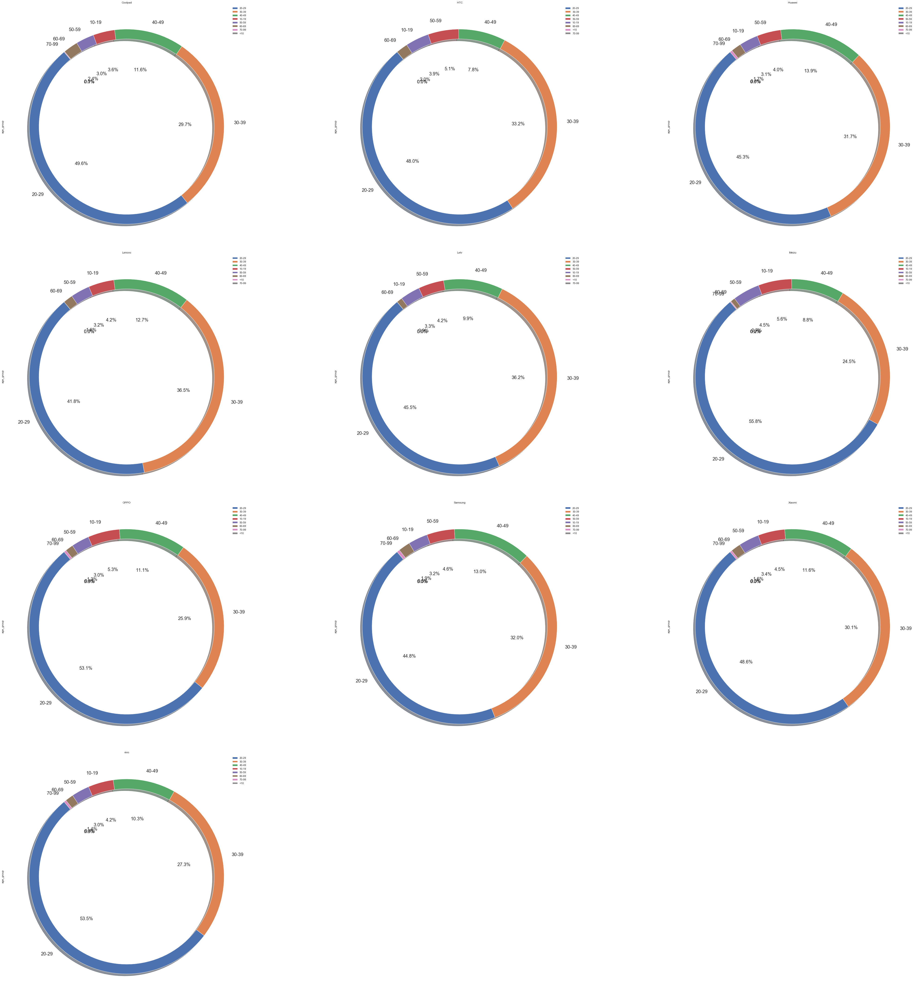

In [104]:
#distribuation of age_group in brand segmengts 

plt.figure(figsize=(20,40), facecolor='white')

# plot numbering starts at 1, not 0
plot_number = 1
for state, selection in dfTopbrands.groupby(['new_brand']):
    # Inside of an image that's a 15x13 grid, put this
    # graph in the in the plot_number slot.
    ax = plt.subplot(4, 3, plot_number)
    #selection['new brand'].value_counts()[:5].sort_values(ascending = True).plot(kind='bar',fontsize=13, figsize=(30,30))
    selection['age_group'].value_counts()[0:10].sort_values(ascending = False).plot(kind='pie', fontsize=20, autopct='%3.1f%%', wedgeprops=dict(width=0.10), shadow=True, startangle=130, figsize=(60,60), legend=True)
    #.value_counts()[:5].plot(kind='pie', fontsize=16, autopct='%3.1f%%', wedgeprops=dict(width=0.15), shadow=True, startangle=130, figsize=(30,30), legend=True)
    ax.set_title(state)
    # Go to the next plot for the next loop
    plot_number = plot_number + 1
    
plt.tight_layout()

In [105]:
df_new['age_group'] = pd.cut(x = df_new['age'], bins = [1,9,19,29,39,49,59,69,79], labels = ['<10','10-19','20-29','30-39','40-49','50-59','60-69','70-99'])

#df_gender['age_group'] = pd.cut(x = df_gender['age'], bins = [1,9,19,29,39,49,59,69,79,89,99], labels = ['<10','10-19','20-29','30-39','40-49','50-59','60-69','70-79','80-89','90-99'])
#gender_age_train['age_group'] = pd.cut(gender_age_train['age'].dropna(),
                                       [1,18,25,35,45,96], labels=['1-17','18-25','26-35','36-45','46+'])


IndentationError: unexpected indent (<ipython-input-105-3afaf2de0509>, line 5)

In [ ]:
df_new.head()          

In [106]:
different lamda uses 

#df['new column name'] = df['column name'].apply(lambda x: 'value if condition is met' if x condition else 'value if condition is not met')
#y = lambda symbol: 'X' if symbol==True else 'O' if symbol==False else ' '
#listofNum = list(filter(lambda x : x > 10 and x < 20, listofNum))
#converter = lambda x : x*2 if x < 10 else (x*3 if x < 20 else x)
#df_final.groupby(['phone_brand','device_model']).agg(lambda x:x.value_counts().index[0])
#df_brand_m2["phone_brand_en"] = df_brand_m2["phone_brand"].map(lambda x: translator.translate(x, src="zh-TW", dest="en").text)
# Replacing null values in df_events_data
#df_events_data.device_id = df_events_data.groupby("city").device_id.transform(lambda x: x.mode()[0])

#df_brand_m2["phone_brand_en"] = df_brand_m2["phone_brand"].map(lambda x: translator.translate(x, src="zh-TW", dest="en").text)
#df_brand_m2
#df_final.groupby(['phone_brand','device_model']).agg(lambda x:x.value_counts().index[0])
#'''df["device_id"] = df.groupby("longitude").transform(lambda x: x.fillna(x.mode()))'''

SyntaxError: invalid syntax (<ipython-input-106-71aae4b8e8d0>, line 1)

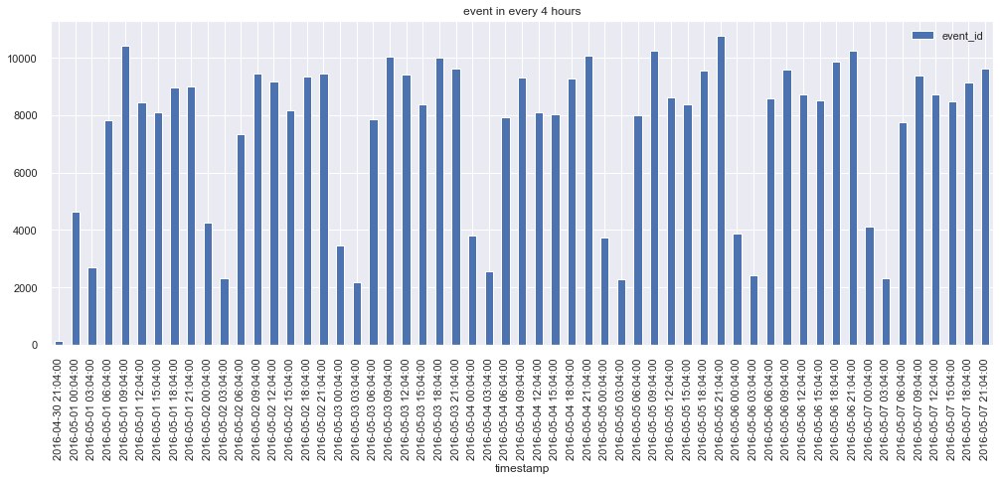

In [107]:
df_datetime= df_new.set_index('timestamp')
df_datetime[['event_id']].resample(rule='3H',loffset='4T').count().plot.bar(figsize=(17,6), title="event in every 4 hours");



9. Plot the Users on the Map using any suitable package.

In [108]:
import folium
import folium.plugins as plugins

In [109]:
lat = df_user['latitude'].tolist()
long = df_user['longitude'].tolist()

coordinates =[]
mapa = folium.Map(location=[23.118370, 70.212684])
# Append latitude and longitude coordinates array
for la,lo in zip(lat,long):
    coordinates.append([la,lo])
   
# We have about 700000 lines, but jupyter notebook ins't possible to show all these points.
# To impress all data you can salve as a html file 
#mapa.save("map.html")
# Or to show onlye a piece
mapa.add_child(plugins.HeatMap(coordinates[0:40000]))

In [110]:
map2 = folium.Map(location=[23.118370, 70.212684])
#for la,lo in zip(lat[0:500],long[0:500]):
for la,lo in zip(lat,long):
    folium.Marker(
        location=[la,lo],
        icon=folium.Icon(icon_color='white')
    ).add_to(map2)
# Plotting 
map2